# Titanic Survival Analysation and Prediction

Analysing the data of Titanic- One of the most tragic shipwreck in history and predicting the survival chances of the passengers onboard.

In [1]:
#Importing the Libraries for Data Analysis and Visualisation.

import numpy as np
import pandas as pd 
pd.plotting.register_matplotlib_converters()
import matplotlib.pyplot as plt
%matplotlib inline
import seaborn as sns

#Ignore warnings
import warnings
warnings.filterwarnings('ignore')
#For colorful text
from termcolor import cprint
print('Setup Complete.')

Setup Complete.


* **
### Acquire Data

Importing the training and test data
* **

In [2]:
train_data = pd.read_csv('train.csv')
test_data = pd.read_csv('test.csv')

* **
### Analysing by describing data

We will use the pandas library to analyse the data.
* **

In [3]:
train_data.columns.values

array(['PassengerId', 'Survived', 'Pclass', 'Name', 'Sex', 'Age', 'SibSp',
       'Parch', 'Ticket', 'Fare', 'Cabin', 'Embarked'], dtype=object)

* **
## Data Dictionary

Variable    |Definition | Key 
:-------: | :--------- | :---: 
survival   |   Survival|    0 = No, 1 = Yes
pclass   |    Ticket class|   1 = 1st, 2 = 2nd, 3 = 3rd
sex   |    Sex|	Male/Female
Age   |    Age in years|	
sibsp   |    # of siblings spouses aboard the Titanic|	
parch   |    # of parents children aboard the Titanic|	
ticket   |    Ticket number|	
fare   |   Passenger fare|	
cabin   |    Cabin number|	
embarked   |   Port of Embarkation|    C = Cherbourg, Q = Queenstown, S = Southampton
* **

In [4]:
#Looking at the top 5 data in the dataset
train_data.head()

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
0,1,0,3,"Braund, Mr. Owen Harris",male,22.0,1,0,A/5 21171,7.2500,NaN,S
1,2,1,1,"Cumings, Mrs. John Bradley (Florence Briggs Th...",female,38.0,1,0,PC 17599,71.2833,C85,C
2,3,1,3,"Heikkinen, Miss. Laina",female,26.0,0,0,STON/O2. 3101282,7.9250,NaN,S
3,4,1,1,"Futrelle, Mrs. Jacques Heath (Lily May Peel)",female,35.0,1,0,113803,53.1000,C123,S
4,5,0,3,"Allen, Mr. William Henry",male,35.0,0,0,373450,8.0500,NaN,S


In [5]:
#Looking at the bottom 5 data in the dataset
train_data.tail()

,PassengerId,Survived,Pclass,Name,Sex,Age,SibSp,Parch,Ticket,Fare,Cabin,Embarked
886,887,0,2,"Montvila, Rev. Juozas",male,27.0,0,0,211536,13.00,NaN,S
887,888,1,1,"Graham, Miss. Margaret Edith",female,19.0,0,0,112053,30.00,B42,S
888,889,0,3,"Johnston, Miss. Catherine Helen ""Carrie""",female,NaN,1,2,W./C. 6607,23.45,NaN,S
889,890,1,1,"Behr, Mr. Karl Howell",male,26.0,0,0,111369,30.00,C148,C
890,891,0,3,"Dooley, Mr. Patrick",male,32.0,0,0,370376,7.75,NaN,Q


In [6]:
cprint(f'Training Data Shape: {train_data.shape}','green')
cprint(f'Test Data Shape: {test_data.shape}','green')

Training Data Shape: (891, 12)
Test Data Shape: (418, 11)


* **
### Describing the Train and Test data
* **

In [7]:
train_data.describe()

,PassengerId,Survived,Pclass,Age,SibSp,Parch,Fare
count,891.000000,891.000000,891.000000,714.000000,891.000000,891.000000,891.000000
mean,446.000000,0.383838,2.308642,29.699118,0.523008,0.381594,32.204208
std,257.353842,0.486592,0.836071,14.526497,1.102743,0.806057,49.693429
min,1.000000,0.000000,1.000000,0.420000,0.000000,0.000000,0.000000
25%,223.500000,0.000000,2.000000,20.125000,0.000000,0.000000,7.910400
50%,446.000000,0.000000,3.000000,28.000000,0.000000,0.000000,14.454200
75%,668.500000,1.000000,3.000000,38.000000,1.000000,0.000000,31.000000
max,891.000000,1.000000,3.000000,80.000000,8.000000,6.000000,512.329200


In [8]:
test_data.describe()

,PassengerId,Pclass,Age,SibSp,Parch,Fare
count,418.000000,418.000000,332.000000,418.000000,418.000000,417.000000
mean,1100.500000,2.265550,30.272590,0.447368,0.392344,35.627188
std,120.810458,0.841838,14.181209,0.896760,0.981429,55.907576
min,892.000000,1.000000,0.170000,0.000000,0.000000,0.000000
25%,996.250000,1.000000,21.000000,0.000000,0.000000,7.895800
50%,1100.500000,3.000000,27.000000,0.000000,0.000000,14.454200
75%,1204.750000,3.000000,39.000000,1.000000,0.000000,31.500000
max,1309.000000,3.000000,76.000000,8.000000,9.000000,512.329200


* **
**What is the data type of the training and test data?**

This helps use during converting features
* **

In [9]:
train_data.info()
cprint('*'*45,'green')
test_data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 891 entries, 0 to 890
Data columns (total 12 columns):
PassengerId    891 non-null int64
Survived       891 non-null int64
Pclass         891 non-null int64
Name           891 non-null object
Sex            891 non-null object
Age            714 non-null float64
SibSp          891 non-null int64
Parch          891 non-null int64
Ticket         891 non-null object
Fare           891 non-null float64
Cabin          204 non-null object
Embarked       889 non-null object
dtypes: float64(2), int64(5), object(5)
memory usage: 83.6+ KB
*********************************************
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 418 entries, 0 to 417
Data columns (total 11 columns):
PassengerId    418 non-null int64
Pclass         418 non-null int64
Name           418 non-null object
Sex            418 non-null object
Age            332 non-null float64
SibSp          418 non-null int64
Parch          418 non-null int64
Ticket         418 non

* **
### Checking for Null Value
* **

In [10]:
cprint('Null Values in training set:','green')
print(train_data.isnull().sum())
cprint('Null Values in test set:','green')
print(test_data.isnull().sum())

Null Values in training set:
PassengerId      0
Survived         0
Pclass           0
Name             0
Sex              0
Age            177
SibSp            0
Parch            0
Ticket           0
Fare             0
Cabin          687
Embarked         2
dtype: int64
Null Values in test set:
PassengerId      0
Pclass           0
Name             0
Sex              0
Age             86
SibSp            0
Parch            0
Ticket           0
Fare             1
Cabin          327
Embarked         0
dtype: int64


* **
### Finding out Relation between Dependent and Independent Variables

Using different kind of plots to find out the relation between Dependent and Independent Variables.
* **

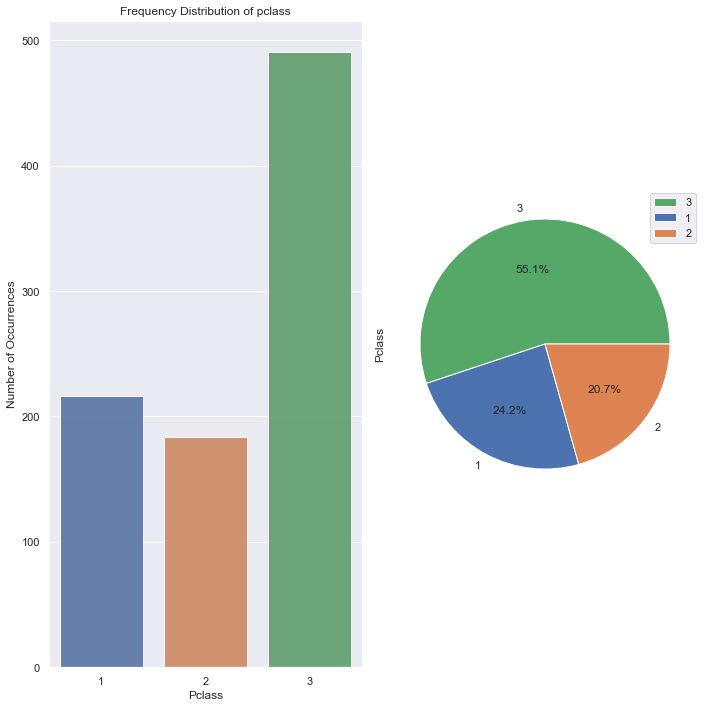

In [11]:
#Frequency Distribution of Pclass

sns.set(style="darkgrid")
plt.subplot(1,2,1)
sns.barplot(train_data['Pclass'].value_counts().index, train_data['Pclass'].value_counts().values, alpha=0.9)
plt.title('Frequency Distribution of pclass')
plt.ylabel('Number of Occurrences', fontsize=12)
plt.xlabel('Pclass', fontsize=12)

plt.subplot(1,2,2)
train_data["Pclass"].value_counts().plot(kind = 'pie', autopct='%1.1f%%', figsize=(10, 10),colors = ('C2','C0','C1')).legend()
plt.tight_layout()
plt.show()

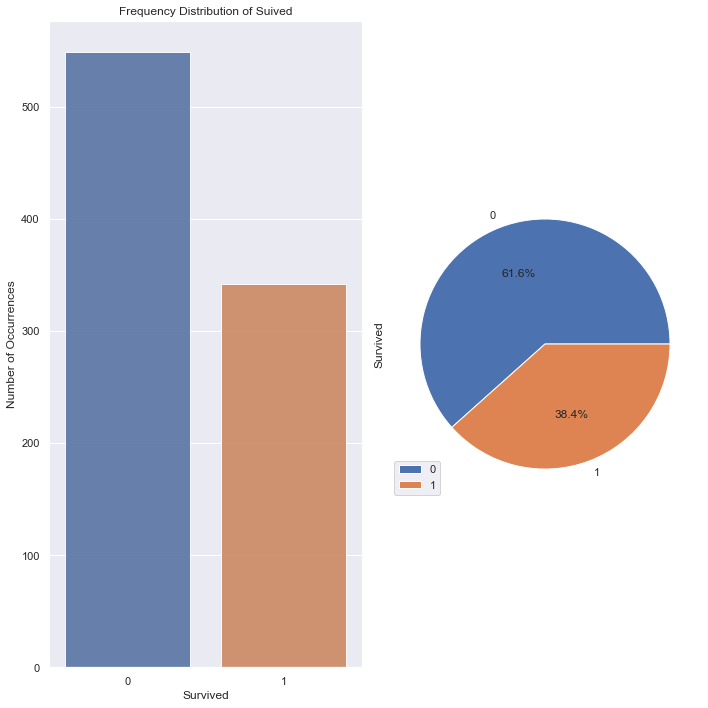

In [12]:
#Frequency Distribution of Survived 

sns.set(style="darkgrid")
plt.subplot(1,2,1)
sns.barplot(train_data['Survived'].value_counts().index, train_data['Survived'].value_counts().values, alpha=0.9)
plt.title('Frequency Distribution of Suived')
plt.ylabel('Number of Occurrences', fontsize=12)
plt.xlabel('Survived', fontsize=12)

plt.subplot(1,2,2)
train_data["Survived"].value_counts().plot(kind = 'pie', autopct='%1.1f%%', figsize=(10, 10)).legend()
plt.tight_layout()
plt.show()

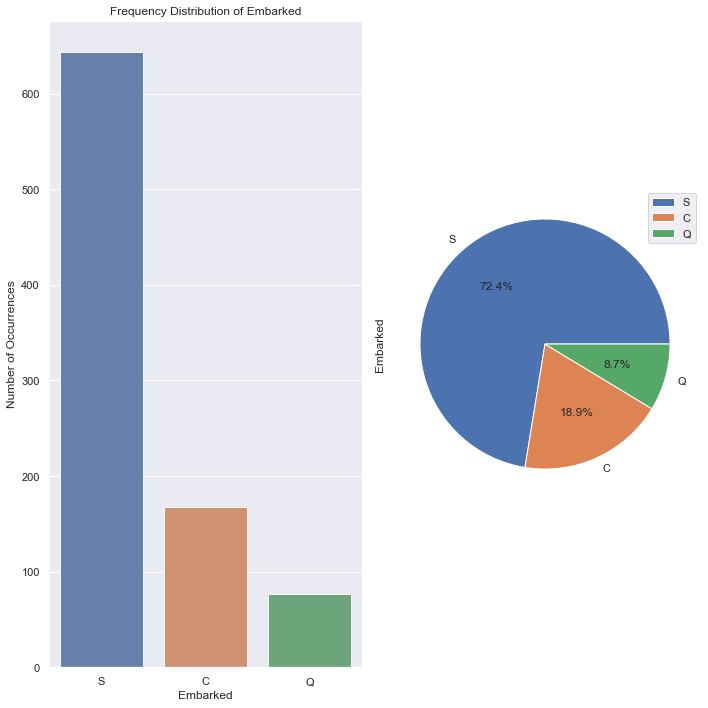

In [13]:
#Frequency Distribution of Embarked

sns.set(style="darkgrid")
plt.subplot(1,2,1)
sns.barplot(train_data['Embarked'].value_counts().index, train_data['Embarked'].value_counts().values, alpha=0.9)
plt.title('Frequency Distribution of Embarked')
plt.ylabel('Number of Occurrences', fontsize=12)
plt.xlabel('Embarked', fontsize=12)

plt.subplot(1,2,2)
train_data["Embarked"].value_counts().plot(kind = 'pie', autopct='%1.1f%%', figsize=(10, 10)).legend()
plt.tight_layout()
plt.show()

* **
### All Features of Training data
* **

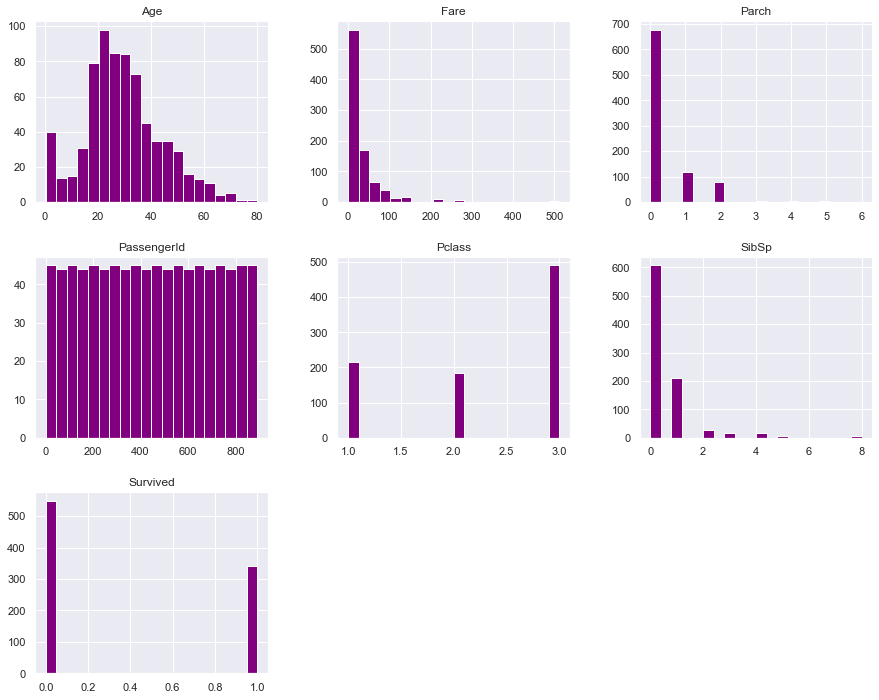

In [14]:
train_data.hist(figsize=(15,12),bins = 20, color="purple")
plt.title("Features Distribution")
plt.show()

* **
### Looking at the corelated features with Survived
* **

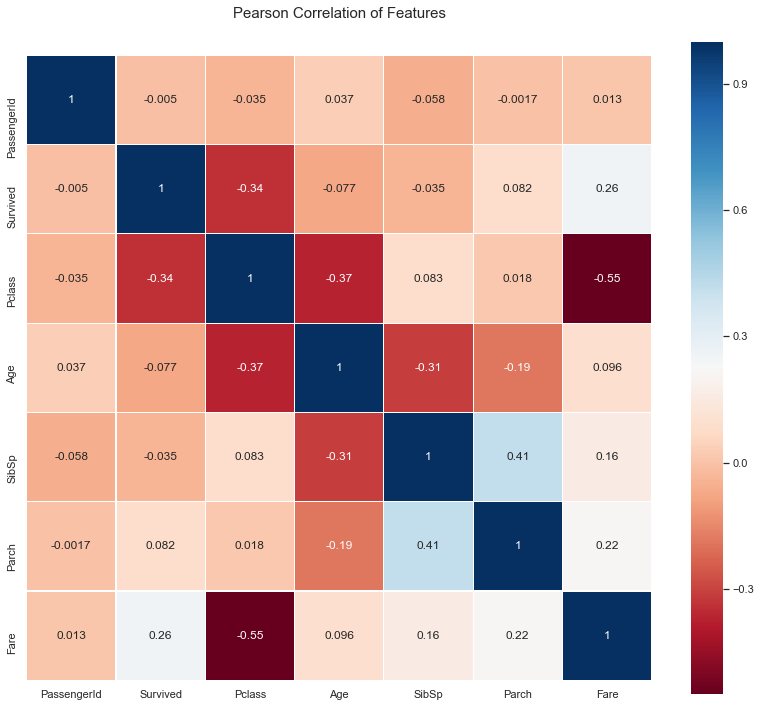

In [15]:
plt.figure(figsize=(14,12))
plt.title('Pearson Correlation of Features', y=1.05, size=15)
sns.heatmap(train_data.corr(),linewidths=0.1,vmax=1.0,square=True, cmap=plt.cm.RdBu, linecolor='white', annot=True);

* **
### Corelation between Features and our Goal(Survived)
* **

In [16]:
# Corelation between Pclass and Survived
train_data[['Pclass','Survived']].groupby('Pclass',as_index=False).mean().sort_values(by='Survived',ascending = False)

,Pclass,Survived
0,1,0.629630
1,2,0.472826
2,3,0.242363


In [17]:
# Corelation between Sex and Survived
train_data[['Sex','Survived']].groupby('Sex',as_index = False).mean().sort_values(by='Survived',ascending = False)

,Sex,Survived
0,female,0.742038
1,male,0.188908


In [18]:
# Corelation between SibSp and Survived
train_data[['SibSp','Survived']].groupby('SibSp',as_index=False).mean().sort_values(by='Survived',ascending=False)

,SibSp,Survived
1,1,0.535885
2,2,0.464286
0,0,0.345395
3,3,0.250000
4,4,0.166667
5,5,0.000000
6,8,0.000000


In [19]:
# Corelation between Parch and Survived
train_data[['Parch','Survived']].groupby('Parch',as_index=False).mean().sort_values(by='Survived',ascending=False)

,Parch,Survived
3,3,0.600000
1,1,0.550847
2,2,0.500000
0,0,0.343658
5,5,0.200000
4,4,0.000000
6,6,0.000000


* **
* **Pclass**: We see significant corelation(>0.5) between Pclass and Survived. We will use this feature in our model.
* **Sex**: We see significant corelation(>0.5) between Sex and Survived. We will use this feature in our model.
* **SibSp and Parch**: We see some values have high corelation and some with zero corelation.

### Age Plot
* **

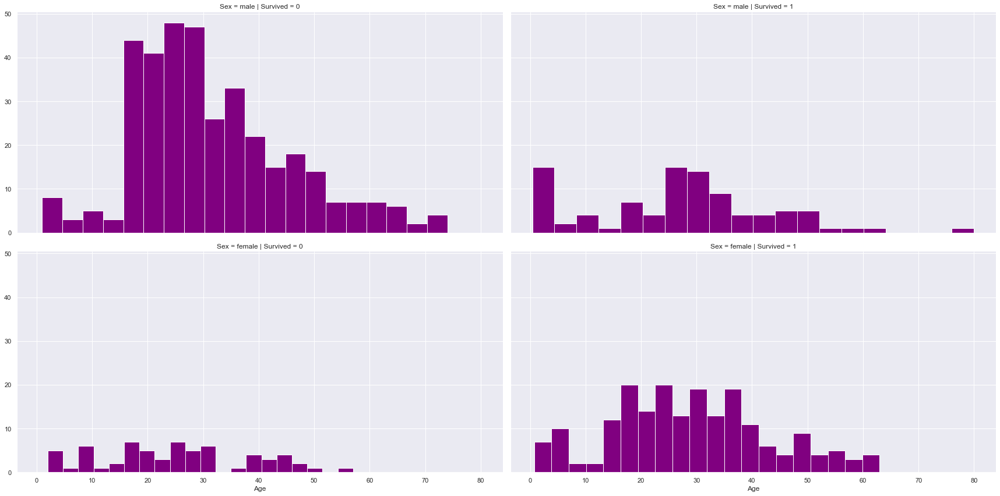

In [20]:
#Frequency Distribution of Survived by Age
g = sns.FacetGrid(train_data, col='Survived',row='Sex',height=6,aspect=2,hue_kws={'color':['purple']})
g.map(plt.hist, 'Age', bins=20);

* **
* As we have seen earlier as well, more females survived as compared to males.
* More kids were on the surviving side.
* As you can see most of the old people did not survive.

### Pclass Plot
* **

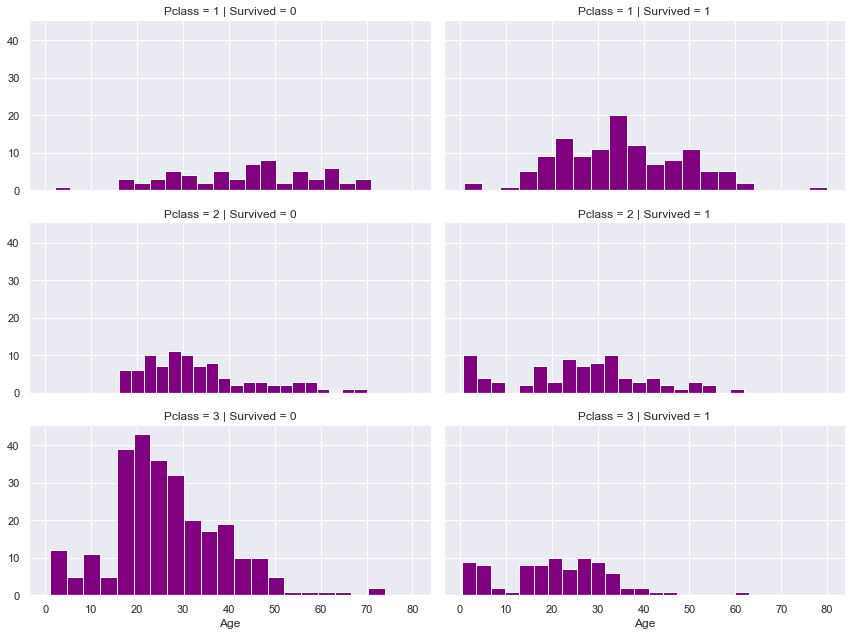

In [21]:
g = sns.FacetGrid(train_data, col='Survived', row='Pclass', size=3, aspect=2,hue_kws={'color':['purple']})
g.map(plt.hist, 'Age', bins=20);

***
* Pclass = 3 had most of the passengers, however many did not survive.
* Mostly passengers from Pclass = 1 survived.
* Infants in Pclass = 1 and Pclass = 2 were luckier than infants in Pcalss = 3.

### Embarked Plot
***

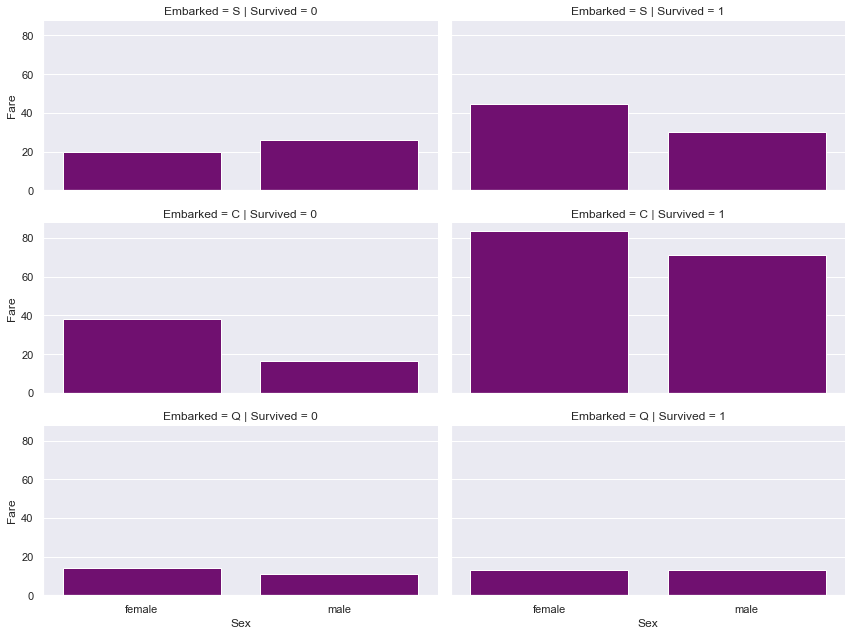

In [22]:
g = sns.FacetGrid(train_data, row='Embarked', col='Survived', size=3, aspect=2, hue_kws={'color':['purple']})
g.map(sns.barplot, 'Sex', 'Fare', ci=None);

***
* Most of the survived passengers had costlier ticket.
* Embarked corelates with Survival rate.

### Feature Enginering and Preperations
***

In [23]:
# Extracting out Dependent Variable from the dataset
y = np.array(train_data['Survived'])

In [24]:
# Combining the train and test dataset so that we can edit both the dataset easily
combined = pd.concat([train_data,test_data],axis=0).reset_index(drop=True)

In [25]:
#Dropping Columns
combined = combined.drop(['Cabin','Name','PassengerId','Ticket','Survived'],axis=1)

***
**Splitting the Age Series into 5 categories and looking at their corelation with Survived**
***

In [26]:
train_data['AgeBand'] = pd.cut(train_data['Age'], 5)
train_data[['AgeBand', 'Survived']].groupby(['AgeBand'], as_index=False).mean().sort_values(by='AgeBand', ascending=True)

,AgeBand,Survived
0,"(0.34, 16.336]",0.550000
1,"(16.336, 32.252]",0.369942
2,"(32.252, 48.168]",0.404255
3,"(48.168, 64.084]",0.434783
4,"(64.084, 80.0]",0.090909


***
**Splitting the Fare Series into 4 categories and looking at their corelation with Survived**
***

In [27]:
train_data['FareBand'] = pd.qcut(train_data['Fare'], 4)
train_data[['FareBand', 'Survived']].groupby(['FareBand'], as_index=False).mean().sort_values(by='FareBand', ascending=True)

,FareBand,Survived
0,"(-0.001, 7.91]",0.197309
1,"(7.91, 14.454]",0.303571
2,"(14.454, 31.0]",0.454955
3,"(31.0, 512.329]",0.581081


***
### Imputing the combined dataset
***

In [28]:
#Filling the empty value in Embarked Series and Mapping it into 3 groups.
combined["Embarked"] = combined["Embarked"].transform(lambda x: x.fillna(x.mode()[0]))
combined['Embarked'] = combined['Embarked'].map( {'S': 0, 'C': 1, 'Q': 2} ).astype(int)

In [29]:
#Filling the empty value in Age Series and Mapping it into 5 groups.
combined.loc[ combined['Age'] <= 16, 'Age'] = 0
combined.loc[(combined['Age'] > 16) & (combined['Age'] <= 32), 'Age'] = 1
combined.loc[(combined['Age'] > 32) & (combined['Age'] <= 48), 'Age'] = 2
combined.loc[(combined['Age'] > 48) & (combined['Age'] <= 64), 'Age'] = 3
combined.loc[ combined['Age'] > 64, 'Age'] = 4 
combined["Age"] = combined["Age"].transform(lambda x: x.fillna(x.mode()[0]))
combined['Age'] = combined['Age'].astype(int)

In [30]:
#Filling the empty value in Fare Series and Mapping it into 4 groups.
combined["Fare"] = combined["Fare"].transform(lambda x: x.fillna(x.mode()[0]))
combined.loc[ combined['Fare'] <= 7.91, 'Fare'] = 0
combined.loc[(combined['Fare'] > 7.91) & (combined['Fare'] <= 14.454), 'Fare'] = 1
combined.loc[(combined['Fare'] > 14.454) & (combined['Fare'] <= 31), 'Fare']   = 2
combined.loc[ combined['Fare'] > 31, 'Fare'] = 3
combined['Fare'] = combined['Fare'].astype(int)

In [31]:
#Categorising the Sex 
combined['Sex'] = combined['Sex'].map( {'female': 1, 'male': 0} ).astype(int)

***
### Splitting the Combined data into Train and Test set
***

In [32]:
combined = pd.get_dummies(combined).reset_index(drop=True)

In [33]:
n = len(y)
train_data = combined[:n]
test_data = combined[n:]

***
### Building the model for training and testing
***

In [34]:
#Importing Libraries for Machine Learning

from sklearn.linear_model import LogisticRegression
from sklearn.svm import SVC
from sklearn.ensemble import RandomForestClassifier
from sklearn.neighbors import KNeighborsClassifier
from sklearn.naive_bayes import GaussianNB
from sklearn.tree import DecisionTreeClassifier
from xgboost import XGBClassifier
from sklearn.model_selection import cross_val_score

from matplotlib.axes._axes import _log as matplotlib_axes_logger
matplotlib_axes_logger.setLevel('ERROR')

In [35]:
X_train = np.array(train_data)
X_test = np.array(test_data)

In [36]:
#Applying PCA (Apply PCA after Data Preprocessing)
from sklearn.decomposition import PCA
pca = PCA(n_components= 2)
X_train = pca.fit_transform(X_train)
X_test = pca.transform(X_test)

In [37]:
#Logistic Regression
logi = LogisticRegression()
logi.fit(X_train,y)
y_pred_logi = logi.predict(X_test)
acc_logi = cross_val_score(logi,X_train,y,cv = 5).mean()
cprint(f'Accuracy of Logistic Regression using K-fold Cross Validation is: {acc_logi}','green')

Accuracy of Logistic Regression using K-fold Cross Validation is: 0.6791631424643068


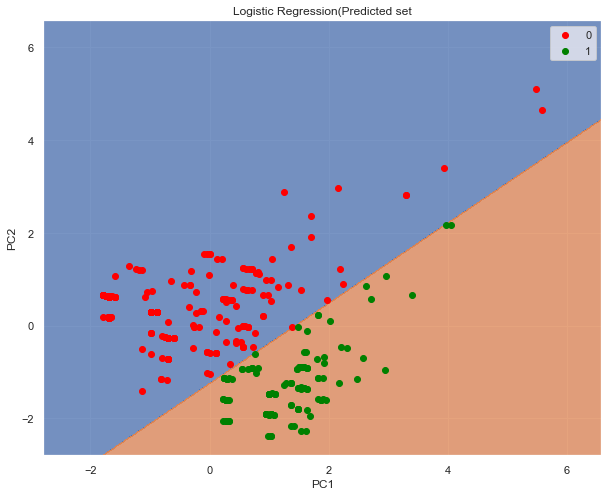

In [38]:
#Visualising the Predicted Value
from matplotlib.colors import ListedColormap
X_set , y_set = X_test , y_pred_logi
plt.figure(figsize=(10,8))
X1,X2 = np.meshgrid(np.arange(start = X_set[:, 0].min()-1,stop = X_set[:,0].max()+1,step = 0.01),np.arange(start = X_set[:, 0].min()-1,stop = X_set[:,0].max()+1,step = 0.01))
plt.contourf(X1, X2, logi.predict(np.array([X1.ravel(),X2.ravel()]).T).reshape(X1.shape),alpha = 0.75,cmap = ListedColormap(('C0','C1')))
plt.xlim(X1.min(),X1.max())
plt.ylim(X2.min(),X2.max())
for i,j in enumerate(np.unique(y_set)):
    plt.scatter(X_set[y_set == j,0],X_set[y_set == j,1],c = ListedColormap(('red','green'))(i), label =j)
plt.title('Logistic Regression(Predicted set')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.legend()
plt.show()

In [39]:
#Linear Support Vector Machine
lin_svc = SVC(kernel='linear')
lin_svc.fit(X_train,y)
y_pred_lin_svc = lin_svc.predict(X_test)
acc_lin_svc = cross_val_score(lin_svc,X_train,y,cv = 5).mean()
cprint(f'Accuracy of Linear Support Vector Machine using K-fold Cross Validation is: {acc_lin_svc}','green')

Accuracy of Linear Support Vector Machine using K-fold Cross Validation is: 0.6791946696683119


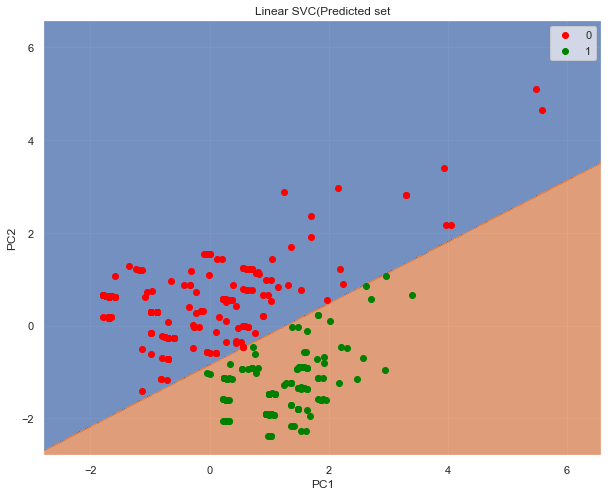

In [40]:
#Visualising the Predicted Value
from matplotlib.colors import ListedColormap
X_set , y_set = X_test , y_pred_lin_svc
plt.figure(figsize=(10,8))
X1,X2 = np.meshgrid(np.arange(start = X_set[:, 0].min()-1,stop = X_set[:,0].max()+1,step = 0.01),np.arange(start = X_set[:, 0].min()-1,stop = X_set[:,0].max()+1,step = 0.01))
plt.contourf(X1, X2, lin_svc.predict(np.array([X1.ravel(),X2.ravel()]).T).reshape(X1.shape),alpha = 0.75,cmap = ListedColormap(('C0','C1')))
plt.xlim(X1.min(),X1.max())
plt.ylim(X2.min(),X2.max())
for i,j in enumerate(np.unique(y_set)):
    plt.scatter(X_set[y_set == j,0],X_set[y_set == j,1],c = ListedColormap(('red','green'))(i), label =j)
plt.title('Linear SVC(Predicted set')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.legend()
plt.show()

In [41]:
#Non-Linear Support Vector Machine
nonlin_svc = SVC(kernel='rbf')
nonlin_svc.fit(X_train,y)
y_pred_nonlin_svc = nonlin_svc.predict(X_test)
acc_nonlin_svc = cross_val_score(nonlin_svc,X_train,y,cv = 5).mean()
cprint(f'Accuracy of Non-Linear Support Vector Machine using K-fold Cross Validation is: {acc_nonlin_svc}','green')

Accuracy of Non-Linear Support Vector Machine using K-fold Cross Validation is: 0.6836322034252942


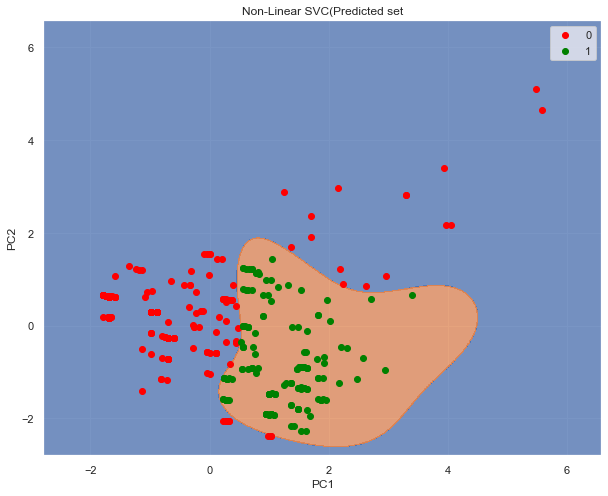

In [42]:
#Visualising the Predicted Value
from matplotlib.colors import ListedColormap
X_set , y_set = X_test , y_pred_nonlin_svc
plt.figure(figsize=(10,8))
X1,X2 = np.meshgrid(np.arange(start = X_set[:, 0].min()-1,stop = X_set[:,0].max()+1,step = 0.01),np.arange(start = X_set[:, 0].min()-1,stop = X_set[:,0].max()+1,step = 0.01))
plt.contourf(X1, X2, nonlin_svc.predict(np.array([X1.ravel(),X2.ravel()]).T).reshape(X1.shape),alpha = 0.75,cmap = ListedColormap(('C0','C1')))
plt.xlim(X1.min(),X1.max())
plt.ylim(X2.min(),X2.max())
for i,j in enumerate(np.unique(y_set)):
    plt.scatter(X_set[y_set == j,0],X_set[y_set == j,1],c = ListedColormap(('red','green'))(i), label =j)
plt.title('Non-Linear SVC(Predicted set')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.legend()
plt.show()

In [43]:
#Random-Forest Classifier
ranfor = RandomForestClassifier(n_estimators=300,criterion='entropy')
ranfor.fit(X_train,y)
y_pred_ranfor = ranfor.predict(X_test)
acc_ranfor = cross_val_score(ranfor,X_train,y,cv = 5).mean()
cprint(f'Accuracy of Random-Forest Classifier using K-fold Cross Validation is: {acc_ranfor}','green')

Accuracy of Random-Forest Classifier using K-fold Cross Validation is: 0.755392517236231


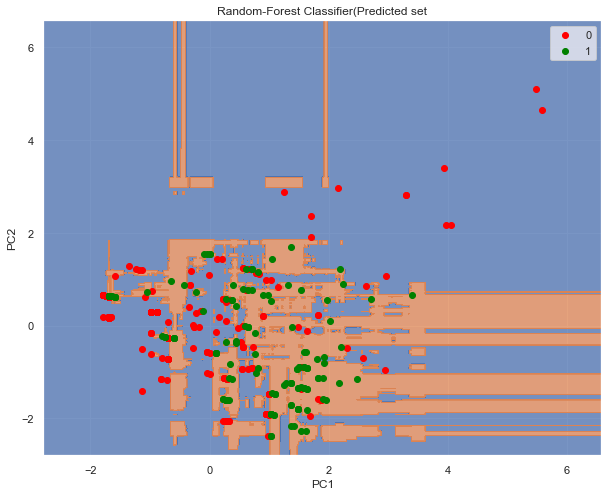

In [44]:
#Visualising the Predicted Value
from matplotlib.colors import ListedColormap
X_set , y_set = X_test , y_pred_ranfor
plt.figure(figsize=(10,8))
X1,X2 = np.meshgrid(np.arange(start = X_set[:, 0].min()-1,stop = X_set[:,0].max()+1,step = 0.01),np.arange(start = X_set[:, 0].min()-1,stop = X_set[:,0].max()+1,step = 0.01))
plt.contourf(X1, X2, ranfor.predict(np.array([X1.ravel(),X2.ravel()]).T).reshape(X1.shape),alpha = 0.75,cmap = ListedColormap(('C0','C1')))
plt.xlim(X1.min(),X1.max())
plt.ylim(X2.min(),X2.max())
for i,j in enumerate(np.unique(y_set)):
    plt.scatter(X_set[y_set == j,0],X_set[y_set == j,1],c = ListedColormap(('red','green'))(i), label =j)
plt.title('Random-Forest Classifier(Predicted set')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.legend()
plt.show()

In [45]:
#KNN Classifier
knn = KNeighborsClassifier()
knn.fit(X_train,y)
y_pred_knn = knn.predict(X_test)
acc_knn = cross_val_score(knn,X_train,y,cv = 5).mean()
cprint(f'Accuracy of K-Nearest Neighbors Classifier using K-fold Cross Validation is: {acc_knn}','green')

Accuracy of K-Nearest Neighbors Classifier using K-fold Cross Validation is: 0.7363602286271977


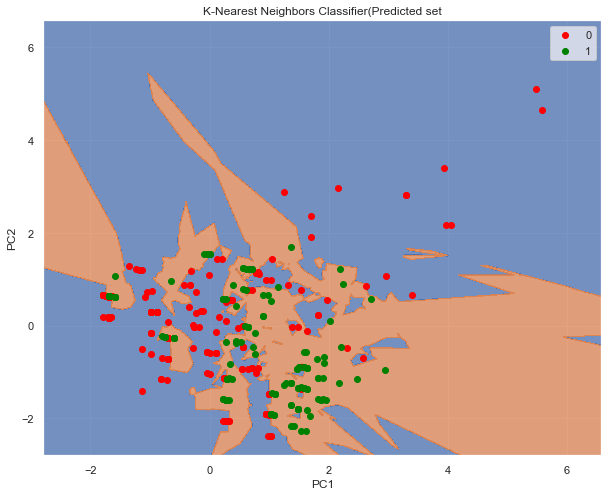

In [46]:
#Visualising the Predicted Value
from matplotlib.colors import ListedColormap
X_set , y_set = X_test , y_pred_knn
plt.figure(figsize=(10,8))
X1,X2 = np.meshgrid(np.arange(start = X_set[:, 0].min()-1,stop = X_set[:,0].max()+1,step = 0.01),np.arange(start = X_set[:, 0].min()-1,stop = X_set[:,0].max()+1,step = 0.01))
plt.contourf(X1, X2, knn.predict(np.array([X1.ravel(),X2.ravel()]).T).reshape(X1.shape),alpha = 0.75,cmap = ListedColormap(('C0','C1')))
plt.xlim(X1.min(),X1.max())
plt.ylim(X2.min(),X2.max())
for i,j in enumerate(np.unique(y_set)):
    plt.scatter(X_set[y_set == j,0],X_set[y_set == j,1],c = ListedColormap(('red','green'))(i), label =j)
plt.title('K-Nearest Neighbors Classifier(Predicted set')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.legend()
plt.show()

In [47]:
#Decision-Tree Classifier
dectre = DecisionTreeClassifier(criterion='entropy')
dectre.fit(X_train,y)
y_pred_dectre = dectre.predict(X_test)
acc_dectre = cross_val_score(dectre,X_train,y,cv = 5).mean()
cprint(f'Accuracy of Decision Tree Classifier using K-fold Cross Validation is: {acc_dectre}','green')

Accuracy of Decision Tree Classifier using K-fold Cross Validation is: 0.7542371817445785


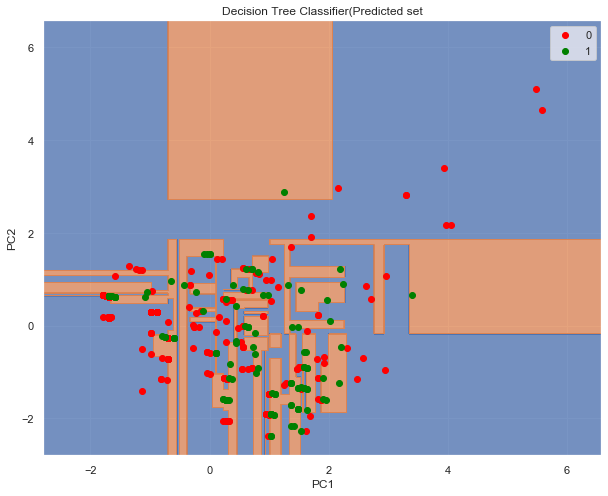

In [48]:
#Visualising the Predicted Value
from matplotlib.colors import ListedColormap
X_set , y_set = X_test , y_pred_dectre
plt.figure(figsize=(10,8))
X1,X2 = np.meshgrid(np.arange(start = X_set[:, 0].min()-1,stop = X_set[:,0].max()+1,step = 0.01),np.arange(start = X_set[:, 0].min()-1,stop = X_set[:,0].max()+1,step = 0.01))
plt.contourf(X1, X2, dectre.predict(np.array([X1.ravel(),X2.ravel()]).T).reshape(X1.shape),alpha = 0.75,cmap = ListedColormap(('C0','C1')))
plt.xlim(X1.min(),X1.max())
plt.ylim(X2.min(),X2.max())
for i,j in enumerate(np.unique(y_set)):
    plt.scatter(X_set[y_set == j,0],X_set[y_set == j,1],c = ListedColormap(('red','green'))(i), label =j)
plt.title('Decision Tree Classifier(Predicted set')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.legend()
plt.show()

In [49]:
# Gaussian Naive Bayes
gaussian = GaussianNB()
gaussian.fit(X_train, y)
y_pred_gaussian = gaussian.predict(X_test)
acc_gaussian = cross_val_score(gaussian,X_train,y,cv = 5).mean()
cprint(f'Accuracy of Naive Bayes Classifier using K-fold Cross Validation is: {acc_gaussian}','green')

Accuracy of Naive Bayes Classifier using K-fold Cross Validation is: 0.6859551448389541


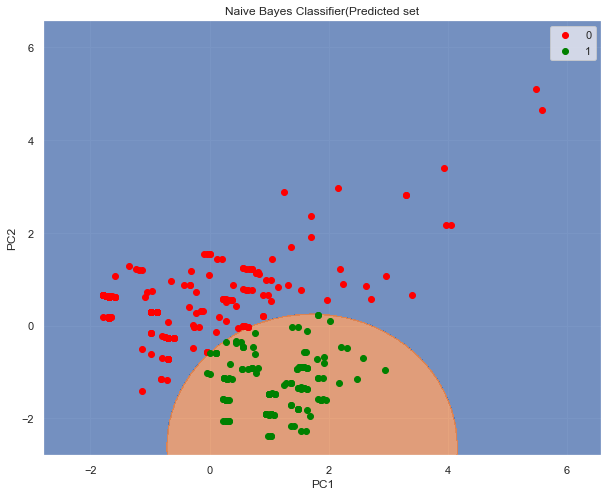

In [50]:
#Visualising the Predicted Value
from matplotlib.colors import ListedColormap
X_set , y_set = X_test , y_pred_gaussian
plt.figure(figsize=(10,8))
X1,X2 = np.meshgrid(np.arange(start = X_set[:, 0].min()-1,stop = X_set[:,0].max()+1,step = 0.01),np.arange(start = X_set[:, 0].min()-1,stop = X_set[:,0].max()+1,step = 0.01))
plt.contourf(X1, X2, gaussian.predict(np.array([X1.ravel(),X2.ravel()]).T).reshape(X1.shape),alpha = 0.75,cmap = ListedColormap(('C0','C1')))
plt.xlim(X1.min(),X1.max())
plt.ylim(X2.min(),X2.max())
for i,j in enumerate(np.unique(y_set)):
    plt.scatter(X_set[y_set == j,0],X_set[y_set == j,1],c = ListedColormap(('red','green'))(i), label =j)
plt.title('Naive Bayes Classifier(Predicted set')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.legend()
plt.show()

In [51]:
# XGBoost Classifier
xgb = XGBClassifier(use_label_encoder=False,eval_metric='error',learning_rate = 0.1,max_depth = 3)
xgb.fit(X_train, y)
y_pred_xgb = xgb.predict(X_test)
acc_xgb = cross_val_score(xgb,X_train,y,cv = 5).mean()
cprint(f'Accuracy of XGBoost Classifier using K-fold Cross Validation is: {acc_xgb}','green')

Accuracy of XGBoost Classifier using K-fold Cross Validation is: 0.7520844304906718


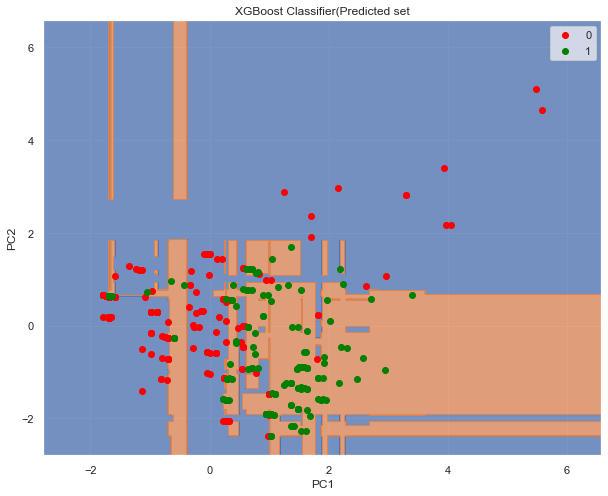

In [52]:
#Visualising the Predicted Value
from matplotlib.colors import ListedColormap
X_set , y_set = X_test , y_pred_xgb
plt.figure(figsize=(10,8))
X1,X2 = np.meshgrid(np.arange(start = X_set[:, 0].min()-1,stop = X_set[:,0].max()+1,step = 0.01),np.arange(start = X_set[:, 0].min()-1,stop = X_set[:,0].max()+1,step = 0.01))
plt.contourf(X1, X2, xgb.predict(np.array([X1.ravel(),X2.ravel()]).T).reshape(X1.shape),alpha = 0.75,cmap = ListedColormap(('C0','C1')))
plt.xlim(X1.min(),X1.max())
plt.ylim(X2.min(),X2.max())
for i,j in enumerate(np.unique(y_set)):
    plt.scatter(X_set[y_set == j,0],X_set[y_set == j,1],c = ListedColormap(('red','green'))(i), label =j)
plt.title('XGBoost Classifier(Predicted set')
plt.xlabel('PC1')
plt.ylabel('PC2')
plt.legend()
plt.show()

***
### Model Evaluation
***

In [53]:
models = pd.DataFrame({
    'Model': ['Linear SVC', 'KNN', 'Logistic Regression', 
              'Random Forest', 'Naive Bayes', 'Non-Linear SVC', 
              'Decision Tree','XGBoost'],
    'Score': [acc_lin_svc, acc_knn, acc_logi, 
              acc_ranfor, acc_gaussian,acc_nonlin_svc, acc_dectre,acc_xgb]})
models.sort_values(by='Score', ascending=False)

,Model,Score
3,Random Forest,0.755393
6,Decision Tree,0.754237
7,XGBoost,0.752084
1,KNN,0.736360
4,Naive Bayes,0.685955
5,Non-Linear SVC,0.683632
0,Linear SVC,0.679195
2,Logistic Regression,0.679163


***
* As Random Forest had the highest score, we will choose it as our final model
***

In [55]:
submission = pd.read_csv('gender_submission.csv')
submission.iloc[:,1] = y_pred_ranfor
submission.to_csv('my_submission.csv',index=False)

***
## Thank You.
***